# Snoring Inference Model

In [1]:
import sys
assert sys.version_info >= (3, 7)

import ssl
ssl._create_default_https_context = ssl._create_unverified_context

#import sklearn
import sklearn
assert sklearn.__version__>="0.20"

#import tensorflow
from packaging import version
import tensorflow as tf
assert version.parse(tf.__version__) >= version.parse("2.8.0")

import os
import soundfile as sf
import librosa
import IPython.display as Ipd
import numpy as np
import time
import threading
import pandas as pd
import joblib #for importing the standard scaler fit to the training data


import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as colors
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# Intro
In this notebook we build an inference loop to see how well the best snoring model (CNN model) performs on randomly selected samples of the training and testing files. We do not have new files as there was only 27 files available.

Through this we hope to implement a procedure or see how this model can be used in real situations. Additioanlly we can see where the model performs well and fails. 

In [2]:
## Load the model
loaded_scaler = joblib.load('standard_scaler.pkl') # load the fitted scaler
model = tf.keras.models.load_model('bin_cnn_model/bin_cnn_model')## Load the model

C:\Users\Brend\miniconda3\envs\audio_mfcc\lib\site-packages\sklearn\base.py:348: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.2.2 when using version 1.3.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


This function is the inference model (or inference function). This function is desinged to imitate a real world situation using the available data. The function begins by loading an audio file and then slicing it into 6.2 second frames, where the following will be conducted on each frame;
+ The frame will be processed it as outlined in the G9-EDA and Preprocessing notebook to obtain 13 MFCC's.
+ The MFCC's will be truncated for to 62.
+ The trained CNN model will predict if the frame based on a 62 length sequnece of 13 MFCC's is snoring or not.

6.2 second frames are chosen as this is what was done in the preprocessing stage.

In [3]:
def calculate_moving_average(data, window_size):
    moving_averages = []
    for i in range(len(data) - window_size + 1):
        window = data[i:i + window_size]
        window_average = sum(window) / window_size
        moving_averages.append(window_average)
    return moving_averages


def snoring_inference_model(audio_file_path, sampling_rate, model, frame_duration=0.1, hop_length=1,scaler=False,offset_level=0,offset_score="average",mov_avg_window=False):
    window_size = 0.1  # CNN model is trained to 100ms so this must be fixed at 0.1, to ensure mfcc's are sampled correctly
    overlap = 0.5 # 50% overlap in mfcc values as done during the preprocessing
    audio_file, original_sr = librosa.load(audio_file_path, sr=sampling_rate) # load the audiofile
    frame_start_time  = 0 #start time
    audio_length_seconds = len(audio_file) / sampling_rate #caluclate audio length
    prediction_list=[] #empty list to store predictions
    threshold = 0.5

    if offset_level > 0:
        inference_dic={"frame_start_time":[],
                           "frame_end_time":[],
                           "prediction":[]}
        while frame_start_time < audio_length_seconds:
    
           
            frame_start_index=int(frame_start_time * original_sr)
            frame_end_index=int((frame_start_time +frame_duration) * original_sr)
            
            inference_dic["frame_start_time"].append(frame_start_time )
            inference_dic["frame_end_time"].append(frame_start_time+frame_duration)
            
            audio_file_trimmed=audio_file[frame_start_index:frame_end_index]
            
            mfccs = librosa.feature.mfcc(y=audio_file_trimmed, sr=sampling_rate, n_mfcc=13,
                                                                    n_fft=int(sampling_rate * window_size), hop_length=int(sampling_rate * window_size*overlap)).transpose()
            mfccs =scaler.transform(mfccs.reshape(-1,13))
            mfccs=mfccs[:62,:]
            mfccs = np.expand_dims(mfccs, axis=0)
            
            prediction = model.predict(mfccs,verbose=0)
            inference_dic["prediction"].append(prediction)

            frame_start_time =frame_start_time + (frame_duration/offset_level)

            if  audio_length_seconds - frame_start_time < frame_duration:
                inference_dic["frame_start_time"].append(frame_start_time )
                inference_dic["frame_end_time"].append(audio_length_seconds)
                inference_dic["prediction"].append(0.00001)# dummy variable
                break
        
        if mov_avg_window is False:
            mov_avg_window=6
            
        frame_start_index_list=calculate_moving_average(inference_dic["frame_start_time"], mov_avg_window)
        frame_end_index_list=calculate_moving_average(inference_dic["frame_end_time"], mov_avg_window)
        prediction_index_list=calculate_moving_average(inference_dic["prediction"], mov_avg_window)
        prediction_index_list = ["S" if item > threshold else "N" for item in prediction_index_list]
        
        prediction_list =  [[l1, l2, l3] for l1, l2, l3 in zip(frame_start_index_list, frame_end_index_list, prediction_index_list)]
        return prediction_list
            
    else:
        #Loop to calculate mfcc's for the frame duraction of 6.2 seconds, which is the interval time the model was trained on
        while frame_start_time < audio_length_seconds:
            #First frame length is invalid as MFCC sequnece length is not long enough
            if frame_start_time < frame_start_time + frame_duration:
                new_instance=[frame_start_time,audio_length_seconds,"INVALID"]
                prediction_list.append(new_instance)
                    
            # Calculate the corresponding sample indices for start and end times
            frame_start_index = int(frame_start_time * original_sr) #obtain the starting index of the frame
            frame_end_index = int((frame_start_time +frame_duration) * original_sr) #obtain the ending index of the frame
            audio_file_trimmed=audio_file[frame_start_index:frame_end_index] #trim the audio into frame duration
            mfccs = librosa.feature.mfcc(y=audio_file_trimmed, sr=sampling_rate, n_mfcc=13, n_fft=int(sampling_rate * window_size), hop_length=int(sampling_rate * window_size*overlap)) #Calculate MFCCs, nfft and hoplength are equal to that when pre-processing for training
            mfccs=mfccs.transpose() #transpose mfcc matrix 
            #Scale the mfccs using the standard scalar trained in the model
            if scaler:
                mfccs_shape=mfccs.shape
                mfccs = scaler.transform(mfccs.reshape(-1,13))
                #reshape back into sequences of MFCCS
                mfccs = mfccs.reshape(mfccs_shape)
            #truncate to 62 mfccs which is the max sequence length the model can process
            mfccs=mfccs[:62,:]
            #make 3D as model expects a (None,62,13) shape
            mfccs = np.expand_dims(mfccs, axis=0)
            
            #predict the mfccs
            prediction = model.predict(mfccs,verbose=0)
            #threshold set to 0.5
           
            #if >0.5 state prediction as snoring
            prediction =(prediction >= threshold).astype(int)
            label = "S" if prediction == 1 else "N"
            #save prediction as instance, list contianing frame start and end time + label
            new_instance=[frame_start_time ,frame_start_time +frame_duration,label]
            #add to prediciton list
            prediction_list.append(new_instance)
            #update frame
            frame_start_time =frame_start_time +frame_duration
            #If frame is <6.2 seconds break loop and mark remaning time as invalid prediciton
            if  audio_length_seconds - frame_start_time < frame_duration:
                new_instance=[frame_start_time,audio_length_seconds,"INVALID"]
                prediction_list.append(new_instance)
                break
    print("End of audio, prediction complete.")
    return prediction_list

The function plot_wavefile_with_labels will plot the amplitude over time. The amplitude is shows as plotting the MFCC's can be a little messy and the amplitude given references to quiter and louder periods in the audio file. Where louder noises are typically snoring when the patient is asleep. The true snoring labels will be present above the aplitude graph and predicted labels below.

The function play_audio_with_labels will produce an audio window, play the trimmed audio file automatically and print the labels after an instance of snoring has been detected

In [10]:
def plot_wavefile_with_labels(audio_file,y_true,y_pred,sample_rate=16000):
    #set up plot
    plt.figure(figsize=(12, 3))
    plt.title('Amplitude Over Time, with true labels (top) and predicted labels (bottom)')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    #plot the Amplitude over time
    librosa.display.waveshow(audio_file, sr=sample_rate)
    #colour mappings dictionary Green if snoring, red if not
    color_mapping = {
        "N": 'red',
        "S": 'green',
        "INVALID":'blue'}
    
    #plot the true  labels
    for interval in y_true:
        true_start_time, true_end_time, true_label = interval
        color = color_mapping.get(true_label, 'blue')  # Default to blue if label not found in color_mapping
        plt.hlines(y=max(audio_file)*1.5, xmin=true_start_time, xmax=true_end_time, color=color, linewidth=10, label=true_label)
    plt.annotate("True Labels", (0,max(trimmed_audio_file)*1.2), arrowprops=None)
    #plot the predicted labels
    for interval in y_pred:
        pred_start_time, pred_end_time, pred_label = interval
        color = color_mapping.get(pred_label, 'blue')  # Default to blue if label not found in color_mapping
        plt.hlines(y=min(audio_file)*1.5, xmin=pred_start_time, xmax=pred_end_time, color=color, linewidth=10, label=pred_label)
    plt.annotate("CNN Predicted Labels", (0,min(trimmed_audio_file)*1.2), arrowprops=None)
    # Create a custom legend for the labels
    handles = [plt.Line2D([0], [0], color=color, linewidth=10) for label, color in color_mapping.items()]
    plt.legend(handles, color_mapping.keys(), loc='center left', bbox_to_anchor=(1, 0.5)) #anchor to outside the plot on right hand side
    plt.show()

# Function to play audio and update the flag when finished
def play_audio(audio_file):
    global audio_finished
    audio_display = Ipd.Audio(audio_file, autoplay=True)
    display(audio_display)
    audio_finished = True
    
#audio_finished = False
def play_audio_with_labels(audio_file,lables_list,sampling_rate):
        
    audio_finished = False
    lables_list_copy = lables_list.copy()
    #get audio duraction
    audio_data, sr = librosa.load(audio_file, sr=16000)
    # Calculate the duration in seconds
    duration_seconds = librosa.get_duration(y=audio_data, sr=sr)
    
    print("Start of Audio, predicted snoring labels will be printed")

    # Start a new thread for audio playback
    audio_thread = threading.Thread(target=play_audio(audio_file))
    audio_thread.start()
    

    # List to store timestamps to remove after iteration
    timestamps_to_remove = []

    # Loop to check the current time and print corresponding label
    start_time = time.time()
    while (time.time() - start_time) < duration_seconds:
        current_time = time.time() - start_time
    
        # Check if the current time matches any timestamp in the labels dictionary
        for interval in lables_list_copy:
            pred_start_time, end_time, label = interval
            if current_time >= end_time:
                if label == "S":
                    print(f"At {current_time:.2f} seconds: Snoring Detected")
                lables_list_copy.remove(interval)  # Add timestamp to remove later
    
    
        time.sleep(0.1)  # Add a small delay
    

    print("Audio playback finished.")

# Examples

The function load_and_trim_audio_file will load and trim a specific part from an audiofile and extract the labels for that part. This is required as the audio files are several hours long. Therefore showing only specific examples is possible. There is nothing special about these samples, these were "plucked" from the labelled csv files. With the aim of investigating how the model performs when reanalysing the wavfiles. 

In [11]:
#Function to load and trim the wav file and labels and
#this functions is very specific to the current label csv file and may need to be updated if this changes
def load_and_trim_audio_file(wav_file_path,labels_file_path, start_time, end_time,save_trimmed_audio=False):#Load the sample

    original_x, original_sr = librosa.load(wav_file_path, sr=16000) # load the wav file with a 16000 sample rate, this is important as the files were trained on resampled 16000, data
    csv_labels =  pd.read_csv(labels_file_path) #load the labels

    #Trimmed down wav labels
    wav_labels=csv_labels[(csv_labels["wav_id"] == wav_file)].iloc[:,:5] # simplify the dataframe obtain first 5 rows
    wav_labels["shifted_start_time"] = wav_labels["start_time"] -start_time #get shifted start time (reset start time to 0)
    wav_labels["shifted_end_time"] = wav_labels["end_time"] -start_time #get shifted end time
    trimmed_wav_labels = wav_labels[(wav_labels['shifted_start_time'] >= 0) & (wav_labels['shifted_start_time'] < (end_time - start_time))]

    #Convert id, shifted start time, "" end time, duration and label to list
    wav_id_list = trimmed_wav_labels['wav_id'].tolist()
    start_time_list = trimmed_wav_labels['shifted_start_time'].tolist()
    end_time_list = trimmed_wav_labels['shifted_end_time'].tolist()
    label_list = trimmed_wav_labels['label'].tolist()

    #Convert labels to N for no snoring or S for any level of snoring
    label_list = [label if label == "N" else "S" for label in label_list]

    #list of lists containing label start time, end time and label 
    true_label_list = [[l1, l2, l3] for l1, l2, l3 in zip(start_time_list, end_time_list, label_list)]
    
    # Calculate the corresponding sample indices for start and end times
    start_sample = int(start_time * original_sr) 
    end_sample = int(end_time * original_sr)
    #create trimmed down audio file
    trimmed_audio_file = original_x[start_sample:end_sample]

    if save_trimmed_audio:
        basename = os.path.basename(wav_file_path)
        output_path = f'{basename}_{round(start_time)}_{round(end_time)}_trimmed_audio_.wav'
        sf.write(output_path, trimmed_audio_file, original_sr )
        return trimmed_audio_file, true_label_list, output_path
    
    return trimmed_audio_file, true_label_list

### Example 1: from 'Video_00_000.wav', trimmed time period from  5264 seconds to 5344 seconds.

In [37]:
audio_data_file = 'audio_files' #location on personal computer update to audio_file
wav_file = 'Video_00_000.wav' #Wav file
wav_file_path = os.path.join(audio_data_file, wav_file) #file path
labels_file_path="Data/padded_truncated_mfcc_100ms.csv"
#load the example
trimmed_audio_file,true_label_list,trimmed_audio_file_path=load_and_trim_audio_file(wav_file_path,labels_file_path, start_time=6469.063063, end_time=6499.588498,save_trimmed_audio=True)

In [49]:
#Predict the data
CNN_predictions=snoring_inference_model(audio_file_path=trimmed_audio_file_path,
              sampling_rate=16000,
              model=model,
              frame_duration=3.076,
              hop_length=1,
              scaler = joblib.load('standard_scaler.pkl'),
             offset_level=1,mov_avg_window=1)

C:\Users\Brend\miniconda3\envs\audio_mfcc\lib\site-packages\sklearn\base.py:348: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.2.2 when using version 1.3.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


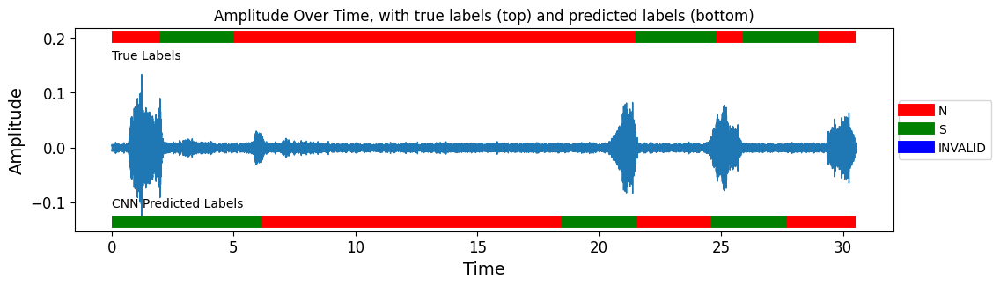

In [50]:
plot_wavefile_with_labels(audio_file=trimmed_audio_file,
                              y_true=true_label_list,
                              y_pred=CNN_predictions,
                              sample_rate=16000)

Example one shows the predicted snoring from the CNN model overlaps the true label. This is consitant with an increase in amplitude. The model also predicts a 2nd snoring instance near the end where the amplitude increases.

In [44]:
play_audio_with_labels(audio_file=trimmed_audio_file_path,lables_list=CNN_predictions,sampling_rate=16000)

Start of Audio, predicted snoring labels will be printed


At 3.17 seconds: Snoring Detected
At 6.22 seconds: Snoring Detected
At 21.62 seconds: Snoring Detected
At 27.73 seconds: Snoring Detected
Audio playback finished.


The Audio clip above shows the end time of the sequence of the predicted snoring audio for the snippet above. The second label at 80.6 seconds appears to coincide with a noise which sounds similar to snoring but was not labelled as so. Potentially the labelling is slightly off rather than the model misinterpreting.

###  Example 2: from 'Video_00_001.wav', trimmed time period from  898 seconds to 1077 seconds.**

In [51]:
audio_data_file = 'audio_files' #location on personal computer update to audio_file
wav_file = 'Video_00_001.wav' #Wav file
wav_file_path = os.path.join(audio_data_file, wav_file) #file path
labels_file_path="Data/padded_truncated_mfcc_100ms.csv"
#load the example
trimmed_audio_file,true_label_list,trimmed_audio_file_path=load_and_trim_audio_file(wav_file_path,labels_file_path, start_time=898.031341, end_time=1076.934658,save_trimmed_audio=True)

In [60]:
#Predict the data
CNN_predictions=snoring_inference_model(audio_file_path=trimmed_audio_file_path,
              sampling_rate=16000,
              model=model,
              frame_duration=3.076,
              hop_length=1,
              scaler = joblib.load('standard_scaler.pkl'),
                                       offset_level=2,mov_avg_window=5)

C:\Users\Brend\miniconda3\envs\audio_mfcc\lib\site-packages\sklearn\base.py:348: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.2.2 when using version 1.3.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


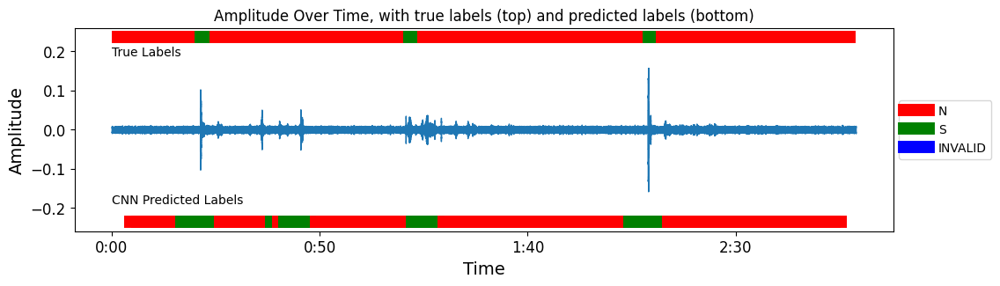

In [61]:
plot_wavefile_with_labels(audio_file=trimmed_audio_file,
                              y_true=true_label_list,
                              y_pred=CNN_predictions,
                              sample_rate=16000)

In [416]:
play_audio_with_labels(audio_file=trimmed_audio_file_path,lables_list=CNN_predictions,sampling_rate=16000)

Start of Audio, predicted snoring labels will be printed


At 24.87 seconds: Snoring Detected
At 49.71 seconds: Snoring Detected
At 55.87 seconds: Snoring Detected
At 80.68 seconds: Snoring Detected
At 105.50 seconds: Snoring Detected
At 130.25 seconds: Snoring Detected
Audio playback finished.


In this example we see the model has two true misclassifications the first at 50 seconds and the  second at 1.40 and three correct snoring predictions. The one at 50 seconds appearst o be associated with a faint noise, which sounds like heavy breathing in the audio. The second misclassification at 1.40 is difficult to decifer as it appears to be assocaited with no elevated sounds. 

###  Example 3: from 'Video_00_037.wav', trimmed time period from  898 seconds to 1077 seconds.**

In [87]:
audio_data_file = 'audio_files' #location on personal computer update to audio_file
wav_file = 'Video_00_000.wav' #Wav file
wav_file_path = os.path.join(audio_data_file, wav_file) #file path
labels_file_path="Data/padded_truncated_mfcc_100ms.csv"
#load the example
trimmed_audio_file,true_label_list,trimmed_audio_file_path=load_and_trim_audio_file(wav_file_path,labels_file_path, 
                                                                                    start_time=6610.820406, 
                                                                                    end_time=7264.685857,
                                                                                    save_trimmed_audio=True)

In [88]:
#Predict the data
CNN_predictions=snoring_inference_model(audio_file_path=trimmed_audio_file_path,
              sampling_rate=16000,
              model=model,
              frame_duration=3.076,
              hop_length=1,
              scaler = joblib.load('standard_scaler.pkl'),
                                       offset_level=2,mov_avg_window=5)

C:\Users\Brend\miniconda3\envs\audio_mfcc\lib\site-packages\sklearn\base.py:348: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.2.2 when using version 1.3.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


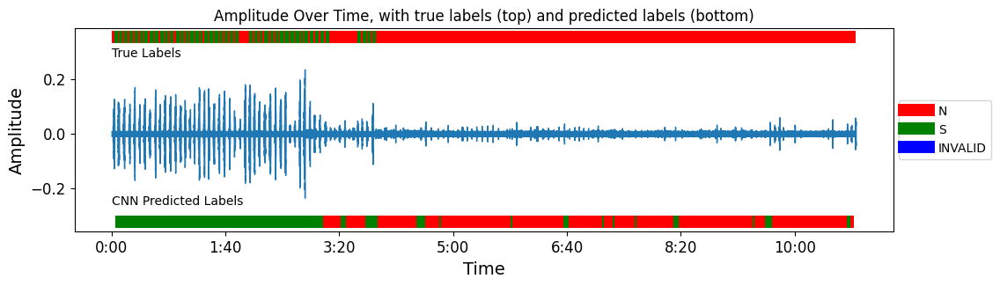

In [89]:
plot_wavefile_with_labels(audio_file=trimmed_audio_file,
                              y_true=true_label_list,
                              y_pred=CNN_predictions,
                              sample_rate=16000)

In [90]:
play_audio_with_labels(audio_file=trimmed_audio_file_path,lables_list=CNN_predictions,sampling_rate=16000)

Start of Audio, predicted snoring labels will be printed


At 6.24 seconds: Snoring Detected
At 7.77 seconds: Snoring Detected
At 9.31 seconds: Snoring Detected
At 10.84 seconds: Snoring Detected
At 12.36 seconds: Snoring Detected
At 13.90 seconds: Snoring Detected
At 15.42 seconds: Snoring Detected
At 16.95 seconds: Snoring Detected
At 18.48 seconds: Snoring Detected
At 20.01 seconds: Snoring Detected
At 21.54 seconds: Snoring Detected
At 23.08 seconds: Snoring Detected
At 24.61 seconds: Snoring Detected
At 26.26 seconds: Snoring Detected
At 27.79 seconds: Snoring Detected
At 29.32 seconds: Snoring Detected
At 30.85 seconds: Snoring Detected
At 32.38 seconds: Snoring Detected
At 33.91 seconds: Snoring Detected
At 35.43 seconds: Snoring Detected
At 36.96 seconds: Snoring Detected
At 38.49 seconds: Snoring Detected
At 40.02 seconds: Snoring Detected
At 41.54 seconds: Snoring Detected
At 43.07 seconds: Snoring Detected
At 44.71 seconds: Snoring Detected
At 46.24 seconds: Snoring Detected
At 47.78 seconds: Snoring Detected
At 49.32 seconds: Snori

In [67]:
audio_data_file = 'audio_files' #location on personal computer update to audio_file
wav_file = 'Video_00_000.wav' #Wav file
wav_file_path = os.path.join(audio_data_file, wav_file) #file path
labels_file_path="Data/padded_truncated_mfcc_100ms.csv"
#load the example
trimmed_audio_file,true_label_list,trimmed_audio_file_path=load_and_trim_audio_file(wav_file_path,labels_file_path, 
                                                                                    start_time=9423.532919, 
                                                                                    end_time=9538.769502,
                                                                                    save_trimmed_audio=True)

In [85]:
#Predict the data
CNN_predictions=snoring_inference_model(audio_file_path=trimmed_audio_file_path,
              sampling_rate=16000,
              model=model,
              frame_duration=3.076,
              hop_length=1,
              scaler = joblib.load('standard_scaler.pkl'),
                                       offset_level=2,mov_avg_window=5)

C:\Users\Brend\miniconda3\envs\audio_mfcc\lib\site-packages\sklearn\base.py:348: InconsistentVersionWarning: Trying to unpickle estimator StandardScaler from version 1.2.2 when using version 1.3.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


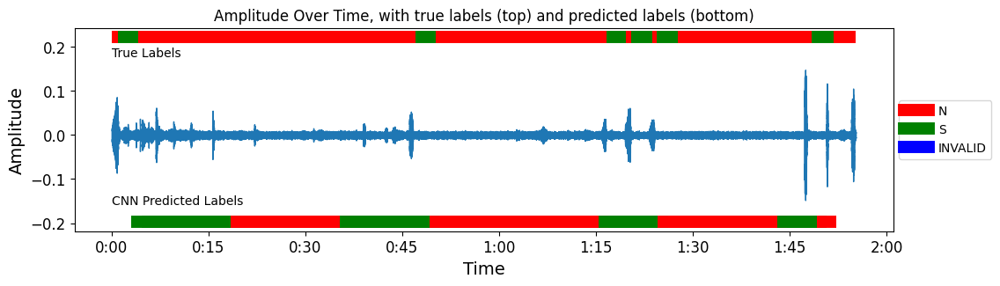

In [86]:
plot_wavefile_with_labels(audio_file=trimmed_audio_file,
                              y_true=true_label_list,
                              y_pred=CNN_predictions,
                              sample_rate=16000)

In [ ]:
play_audio_with_labels(audio_file=trimmed_audio_file_path,lables_list=CNN_predictions,sampling_rate=16000)